<a href="https://colab.research.google.com/github/tigerofmurder/Compresion_imagenes/blob/main/COMPRESION.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torchvision.utils import make_grid
import torchvision.utils as vutils
import matplotlib.animation as animation
from IPython.display import HTML

import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import pandas as pd
import copy
import time
import cv2 as cv
from tqdm import tqdm_notebook as tqdm
import matplotlib.image as mpimg

import torchvision.transforms.functional as TF

In [2]:
#%cd /content/drive/MyDrive/Datset/
#import os
#os.environ['KAGGLE_CONFIG_DIR'] = "/content/drive/MyDrive/Datset/"

#!kaggle datasets download -d hsankesara/flickr-image-dataset

In [3]:
#!ls

In [4]:
#!unzip flickr-image-dataset.zip

In [5]:
!nvidia-smi

Mon Dec 28 13:10:20 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.27.04    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   46C    P8    10W /  70W |      0MiB / 15079MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [6]:
import os
img_dir = '/content/drive/MyDrive/Datset/flickr30k_images/flickr30k_images/'
img_list = os.listdir(img_dir)
print(len(img_list))

483


In [7]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
import matplotlib.image as mpimg
import torchvision
from torchvision import transforms


valid_ratio = 0.8
class ImageData(Dataset):
    def __init__(self,is_train=True):
        self.is_train = is_train
        self.transform = transforms.Compose([transforms.ToTensor(),])
        self.train_index = int(valid_ratio * len(img_list))
        self.crop = torchvision.transforms.CenterCrop((218,178))
    def __len__(self):
        if self.is_train:
            return self.train_index
        else:
            return len(img_list) - self.train_index -1
    def __getitem__(self, index):
        if not self.is_train:
            index = self.train_index + index
        img = mpimg.imread(img_dir+img_list[index])
        img = self.crop(TF.to_pil_image(img))
        img = self.transform(img)
        img = (img-0.5) /0.5
        return img

In [8]:
#CANTIDAD DE IMAGENES A TOMAR ES DECIR CARGA LOS DATOS POR LOTES DE UN TAMAÑO N
batch_size=20
dataset = ImageData()
#Shuffle, Los datos se reorganizan en cada epoch
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
#Un conjunto de datos de estilo mapa es aquel que implementa los protocolos __getitem__()y __len__(), y representa un mapa de índices / claves (posiblemente no integrales) a muestras de datos.

torch.Size([3, 218, 178])
torch.Size([218, 178, 3])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


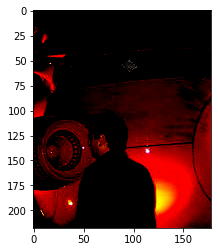

In [9]:
a = next(iter(dataloader))
print(a[0].shape)
img = a[15]
print(img.permute(1,2,0).shape) #reordenamos las dimesiones de forma concreta
plt.imshow(img.permute(1,2,0))

In [10]:
IMG_WIDTH = 178
IMG_HEIGHT = 218
#latent_size = 200
device = 'cuda'
num_channels_in_encoder = 8


def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [11]:
"""
import torch
import torch.nn as nn
#compresion
class Encoder(nn.Module):
    def __init__(self):
        super(Encoder, self).__init__()
        
        # ENCODER

        # 64x64x64
        self.e_conv_1 = nn.Sequential(
            nn.ZeroPad2d((1, 2, 1, 2)),
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=(5, 5), stride=(2, 2)),nn.LeakyReLU()
        )

        # 128x32x32
        self.e_conv_2 = nn.Sequential(
            nn.ZeroPad2d((1, 2, 1, 2)),
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=(5, 5), stride=(2, 2)),
            nn.LeakyReLU()
        )
        
        # 128x32x32
        self.e_block_1 = nn.Sequential(
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
        )

        # 128x32x32
        self.e_block_2 = nn.Sequential(
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
        )

        # 128x32x32
        self.e_block_3 = nn.Sequential(
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
        )

        # 32x32x32
        self.e_conv_3 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=num_channels_in_encoder, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2)),
            nn.Tanh()
        )
    def forward(self, x):
        ec1 = self.e_conv_1(x)
        ec2 = self.e_conv_2(ec1)
        eblock1 = self.e_block_1(ec2) + ec2
        #eblock2 = self.e_block_2(eblock1) + eblock1
        eblock3 = self.e_block_3(eblock1) + eblock1
        ec3 = self.e_conv_3(eblock3)
        return ec3
    """

'\nimport torch\nimport torch.nn as nn\n#compresion\nclass Encoder(nn.Module):\n    def __init__(self):\n        super(Encoder, self).__init__()\n        \n        # ENCODER\n\n        # 64x64x64\n        self.e_conv_1 = nn.Sequential(\n            nn.ZeroPad2d((1, 2, 1, 2)),\n            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=(5, 5), stride=(2, 2)),nn.LeakyReLU()\n        )\n\n        # 128x32x32\n        self.e_conv_2 = nn.Sequential(\n            nn.ZeroPad2d((1, 2, 1, 2)),\n            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=(5, 5), stride=(2, 2)),\n            nn.LeakyReLU()\n        )\n        \n        # 128x32x32\n        self.e_block_1 = nn.Sequential(\n            nn.ZeroPad2d((1, 1, 1, 1)),\n            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),\n            nn.LeakyReLU(),\n\n            nn.ZeroPad2d((1, 1, 1, 1)),\n            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1))

In [12]:
#Compresor
class Encoder(nn.Module):
    def __init__(self):
        super(Encoder, self).__init__()
        self.encoded = None
        # 64x64x64
        self.e_conv_1 = nn.Sequential(
            nn.ZeroPad2d((1, 2, 1, 2)),
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=(5, 5), stride=(2, 2)),
            nn.LeakyReLU()
        )

        # 128x32x32
        self.e_conv_2 = nn.Sequential(
            nn.ZeroPad2d((1, 2, 1, 2)),
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=(5, 5), stride=(2, 2)),
            nn.LeakyReLU()
        )
        
        # 128x32x32
        self.e_block_1 = nn.Sequential(
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
        )

        # 128x32x32
        self.e_block_2 = nn.Sequential(
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
        )

        # 128x32x32
        self.e_block_3 = nn.Sequential(
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
        )

        # 32x32x32
        self.e_conv_3 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=num_channels_in_encoder, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2)),
            nn.Tanh()
        )
    def forward(self, x):
        ec1 = self.e_conv_1(x)
        ec2 = self.e_conv_2(ec1)
        eblock1 = self.e_block_1(ec2) + ec2
        eblock2 = self.e_block_2(eblock1) + eblock1
        eblock3 = self.e_block_3(eblock2) + eblock2
        ec3 = self.e_conv_3(eblock3)  # in [-1, 1] from tanh activation
        return ec3

In [13]:
netE = Encoder().to(device)
netE.apply(weights_init)
'''inp = torch.randn(IMG_WIDTH*IMG_HEIGHT*3 * 100)
inp = inp.view((-1,3,IMG_HEIGHT,IMG_WIDTH))
output = netE(inp.to(device))
print(output.shape)
print('Compresion :  ' + str((output.shape[1]*output.shape[2]*output.shape[3])/(IMG_WIDTH*IMG_HEIGHT*3)*100) )'''

"inp = torch.randn(IMG_WIDTH*IMG_HEIGHT*3 * 100)\ninp = inp.view((-1,3,IMG_HEIGHT,IMG_WIDTH))\noutput = netE(inp.to(device))\nprint(output.shape)\nprint('Compresion :  ' + str((output.shape[1]*output.shape[2]*output.shape[3])/(IMG_WIDTH*IMG_HEIGHT*3)*100) )"

In [14]:
!nvidia-smi
torch.cuda.empty_cache()
!nvidia-smi

Mon Dec 28 13:10:25 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.27.04    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   46C    P0    28W /  70W |    955MiB / 15079MiB |      6%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [15]:
'''# Generador

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.d_up_conv_1 = nn.Sequential(
        nn.Conv2d(in_channels=num_channels_in_encoder, out_channels=64, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.ConvTranspose2d(in_channels=64, out_channels=128, kernel_size=(2, 2), stride=(2, 2))
        )

        # 128x64x64
        self.d_block_1 = nn.Sequential(
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
        )

        # 128x64x64
        self.d_block_2 = nn.Sequential(
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
        )

        # 128x64x64
        self.d_block_3 = nn.Sequential(
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
        )

        # 256x128x128
        self.d_up_conv_2 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=32, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.ConvTranspose2d(in_channels=32, out_channels=256, kernel_size=(2, 2), stride=(2, 2))
        )

        # 3x128x128
        self.d_up_conv_3 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=16, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ReflectionPad2d((3, 3, 3, 3)),
            nn.Conv2d(in_channels=16, out_channels=3, kernel_size=(3, 3), stride=(1, 1)),
            nn.Tanh()
        )

        
        
    def forward(self, x):
        uc1 = self.d_up_conv_1(x)
        dblock1 = self.d_block_1(uc1) + uc1
        #dblock2 = self.d_block_2(dblock1) + dblock1
        dblock3 = self.d_block_3(dblock1) + dblock1
        uc2 = self.d_up_conv_2(dblock3)
        dec = self.d_up_conv_3(uc2)
        return dec
        '''

'# Generador\n\nclass Generator(nn.Module):\n    def __init__(self):\n        super(Generator, self).__init__()\n        self.d_up_conv_1 = nn.Sequential(\n        nn.Conv2d(in_channels=num_channels_in_encoder, out_channels=64, kernel_size=(3, 3), stride=(1, 1)),\n            nn.LeakyReLU(),\n\n            nn.ZeroPad2d((1, 1, 1, 1)),\n            nn.ConvTranspose2d(in_channels=64, out_channels=128, kernel_size=(2, 2), stride=(2, 2))\n        )\n\n        # 128x64x64\n        self.d_block_1 = nn.Sequential(\n            nn.ZeroPad2d((1, 1, 1, 1)),\n            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),\n            nn.LeakyReLU(),\n\n            nn.ZeroPad2d((1, 1, 1, 1)),\n            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),\n        )\n\n        # 128x64x64\n        self.d_block_2 = nn.Sequential(\n            nn.ZeroPad2d((1, 1, 1, 1)),\n            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(

In [16]:
# Generador

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()

        # 128x64x64
        self.d_up_conv_1 = nn.Sequential(
        nn.Conv2d(in_channels=num_channels_in_encoder, out_channels=64, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.ConvTranspose2d(in_channels=64, out_channels=128, kernel_size=(2, 2), stride=(2, 2))
        )

        # 128x64x64
        self.d_block_1 = nn.Sequential(
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
        )

        # 128x64x64
        self.d_block_2 = nn.Sequential(
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
        )

        # 128x64x64
        self.d_block_3 = nn.Sequential(
            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=(3, 3), stride=(1, 1)),
        )

        # 256x128x128
        self.d_up_conv_2 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=32, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ZeroPad2d((1, 1, 1, 1)),
            nn.ConvTranspose2d(in_channels=32, out_channels=256, kernel_size=(2, 2), stride=(2, 2))
        )

        # 3x128x128
        self.d_up_conv_3 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=16, kernel_size=(3, 3), stride=(1, 1)),
            nn.LeakyReLU(),

            nn.ReflectionPad2d((3, 3, 3, 3)),
            nn.Conv2d(in_channels=16, out_channels=3, kernel_size=(3, 3), stride=(1, 1)),
            nn.Tanh()
        )

        
        
    def forward(self, x):
        uc1 = self.d_up_conv_1(x)
        dblock1 = self.d_block_1(uc1) + uc1
        dblock2 = self.d_block_2(dblock1) + dblock1
        dblock3 = self.d_block_3(dblock2) + dblock2
        uc2 = self.d_up_conv_2(dblock3)
        dec = self.d_up_conv_3(uc2)
        return dec

In [17]:
netG = Generator().to(device)
netG.apply(weights_init)
#inp = torch.randn(100*num_channels_in_encoder*54*44).view((-1,num_channels_in_encoder,54,44)).to(device)
#output = netG(inp)
#print(output.shape)
#218 * 178

Generator(
  (d_up_conv_1): Sequential(
    (0): Conv2d(8, 64, kernel_size=(3, 3), stride=(1, 1))
    (1): LeakyReLU(negative_slope=0.01)
    (2): ZeroPad2d(padding=(1, 1, 1, 1), value=0.0)
    (3): ConvTranspose2d(64, 128, kernel_size=(2, 2), stride=(2, 2))
  )
  (d_block_1): Sequential(
    (0): ZeroPad2d(padding=(1, 1, 1, 1), value=0.0)
    (1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1))
    (2): LeakyReLU(negative_slope=0.01)
    (3): ZeroPad2d(padding=(1, 1, 1, 1), value=0.0)
    (4): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1))
  )
  (d_block_2): Sequential(
    (0): ZeroPad2d(padding=(1, 1, 1, 1), value=0.0)
    (1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1))
    (2): LeakyReLU(negative_slope=0.01)
    (3): ZeroPad2d(padding=(1, 1, 1, 1), value=0.0)
    (4): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1))
  )
  (d_block_3): Sequential(
    (0): ZeroPad2d(padding=(1, 1, 1, 1), value=0.0)
    (1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1))
   

In [18]:
!nvidia-smi

Mon Dec 28 13:10:26 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.27.04    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   47C    P0    28W /  70W |    959MiB / 15079MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [19]:
torch.cuda.empty_cache()

In [20]:
# Discriminator
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.latent_layer1 = nn.Sequential(
            nn.ConvTranspose2d(num_channels_in_encoder, 12, (3,3), stride=1, padding=0, output_padding=0, groups=1, bias=True, dilation=1),
            nn.LeakyReLU(negative_slope=0.2, inplace=True),
        )
        self.latent_layer2 = nn.Sequential(
            nn.ConvTranspose2d(12, 16, (3,3), stride=1, padding=2, output_padding=0, groups=1, bias=True, dilation=1),
            nn.LeakyReLU(negative_slope=0.2, inplace=True),
        )
        self.latent_layer3 = nn.Sequential(
            nn.ConvTranspose2d(16, 24, (3,3), stride=2, padding=2, output_padding=1, groups=1, bias=True, dilation=1),
            nn.LeakyReLU(negative_slope=0.2, inplace=True),
        )
        self.latent_layer4 = nn.Sequential(
            nn.ConvTranspose2d(24, 36, (5,5), stride=2, padding=0, output_padding=1, groups=1, bias=True, dilation=1),
            nn.LeakyReLU(negative_slope=0.2, inplace=True),
        )
        self.latent_layer5 = nn.Sequential(
            nn.ConvTranspose2d(36, 3, (3,3), stride=1, padding=0, output_padding=0, groups=1, bias=True, dilation=1),
            nn.LeakyReLU(negative_slope=0.2, inplace=True),
            nn.Tanh(),
        )

        
        self.layer1 = nn.Sequential(
            nn.Conv2d(in_channels=6, out_channels=64, kernel_size=3,stride = 1,padding=0),
            nn.LeakyReLU(negative_slope=0.2, inplace=True),
            nn.Dropout(0.3),
        )
        self.layer2 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=5,stride = 2,padding=0),
            nn.LeakyReLU(negative_slope=0.2, inplace=True),
            nn.Dropout(0.3),
        )
        self.layer3 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=32, kernel_size=3,stride = 2,padding=2),
            nn.LeakyReLU(negative_slope=0.2, inplace=True),
            nn.Dropout(0.3),
        )
        self.layer4 = nn.Sequential(
            nn.Conv2d(in_channels=32, out_channels=16, kernel_size=3,stride = 1,padding=2),
            nn.LeakyReLU(negative_slope=0.2, inplace=True),
            nn.Dropout(0.3),
        )
        self.layer5 = nn.Sequential(
            nn.Conv2d(in_channels=16, out_channels=8, kernel_size=3,stride = 1,padding=0),
            nn.LeakyReLU(negative_slope=0.2, inplace=True),
            nn.Dropout(0.3),
            nn.Tanh(),
        )
        
        
        self.fc1 = nn.Sequential(
            nn.Linear(8*54*44,2000),
            nn.Sigmoid(),
        )
        
        self.fc2 = nn.Sequential(
            nn.Linear(2000,100),
            nn.Sigmoid(),
        )
        self.fc3 = nn.Sequential(
            nn.Linear(100,1),
            nn.Sigmoid(),
        )
        
        
    def forward(self, x):
        y = x['encoded'].to(device)
        y = self.latent_layer1(y)
        y = self.latent_layer2(y)
        y = self.latent_layer3(y)
        y = self.latent_layer4(y)
        y = self.latent_layer5(y)
#         print(y.shape)
        x = x['img'].to(device)
#         print(x.shape)
        x = torch.cat((x,y),1)
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        x = self.layer5(x)
#         print(x.shape)
        x= x.reshape((x.shape[0],-1))
        x = self.fc1(x)
        x = self.fc2(x)
        x = self.fc3(x)
        return x

In [21]:
netD = Discriminator().to(device)
netD.apply(weights_init)

Discriminator(
  (latent_layer1): Sequential(
    (0): ConvTranspose2d(8, 12, kernel_size=(3, 3), stride=(1, 1))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (latent_layer2): Sequential(
    (0): ConvTranspose2d(12, 16, kernel_size=(3, 3), stride=(1, 1), padding=(2, 2))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (latent_layer3): Sequential(
    (0): ConvTranspose2d(16, 24, kernel_size=(3, 3), stride=(2, 2), padding=(2, 2), output_padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (latent_layer4): Sequential(
    (0): ConvTranspose2d(24, 36, kernel_size=(5, 5), stride=(2, 2), output_padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (latent_layer5): Sequential(
    (0): ConvTranspose2d(36, 3, kernel_size=(3, 3), stride=(1, 1))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Tanh()
  )
  (layer1): Sequential(
    (0): Conv2d(6, 64, kernel_size=(3, 3), stride=(1, 1))
    (1): LeakyReLU(negative_slo

In [22]:
!nvidia-smi
torch.cuda.empty_cache()

Mon Dec 28 13:10:26 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.27.04    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   47C    P0    28W /  70W |   1107MiB / 15079MiB |     10%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [23]:
lr = 0.0002
criterion = nn.BCELoss()
msecriterion = nn.MSELoss()
l1criterion = nn.L1Loss()
# Establecer las etiquetas reales y falsas durante el entrenamiento
real_label = 1
fake_label = 0

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(0.5, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(0.5, 0.999))
optimizerE = optim.Adam(netE.parameters(), lr=lr, betas=(0.5, 0.999))

In [24]:
valid_dataset = ImageData(is_train=False)
num_images_to_show = 1
valid_dataloader = DataLoader(valid_dataset, batch_size=num_images_to_show, shuffle=True)
valid_batch = next(iter(valid_dataloader)).to(device)

In [25]:
#torch.autograd.set_detect_anomaly (True)
%cd /content/drive/MyDrive/

/content/drive/MyDrive


In [26]:
G_losses = []
D_losses = []
E_losses = []
!nvidia-smi
torch.cuda.empty_cache()


Mon Dec 28 13:10:27 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.27.04    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   46C    P0    28W /  70W |   1107MiB / 15079MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

[0/30][0/20]	Loss_D: 1.3961	Loss_G: 0.8861	Loss_E: 0.8861	D(x): 0.4552	D(G(z)): 0.4552 / 0.5351


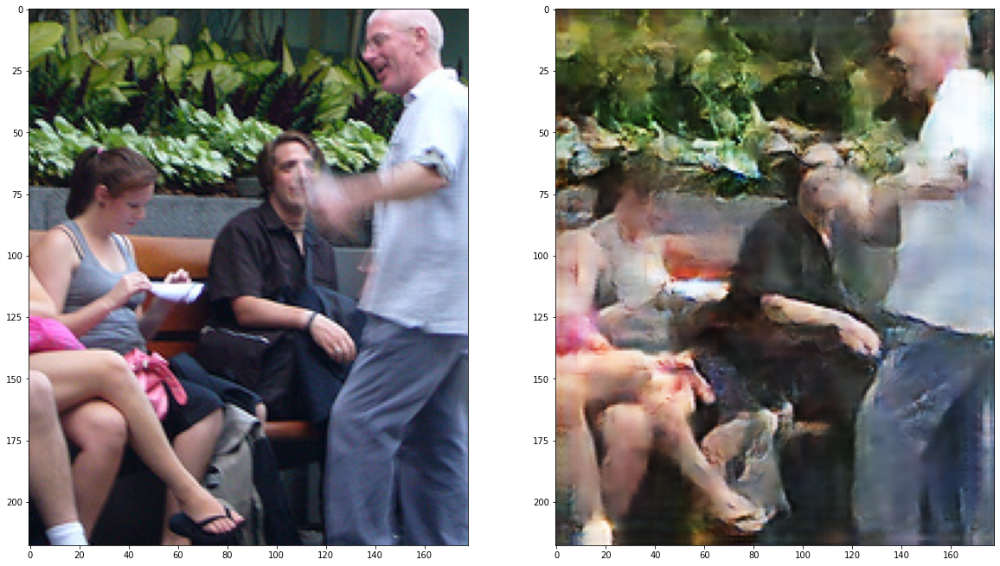

[1/30][0/20]	Loss_D: 1.3886	Loss_G: 0.9201	Loss_E: 0.9201	D(x): 0.4798	D(G(z)): 0.4799 / 0.5097


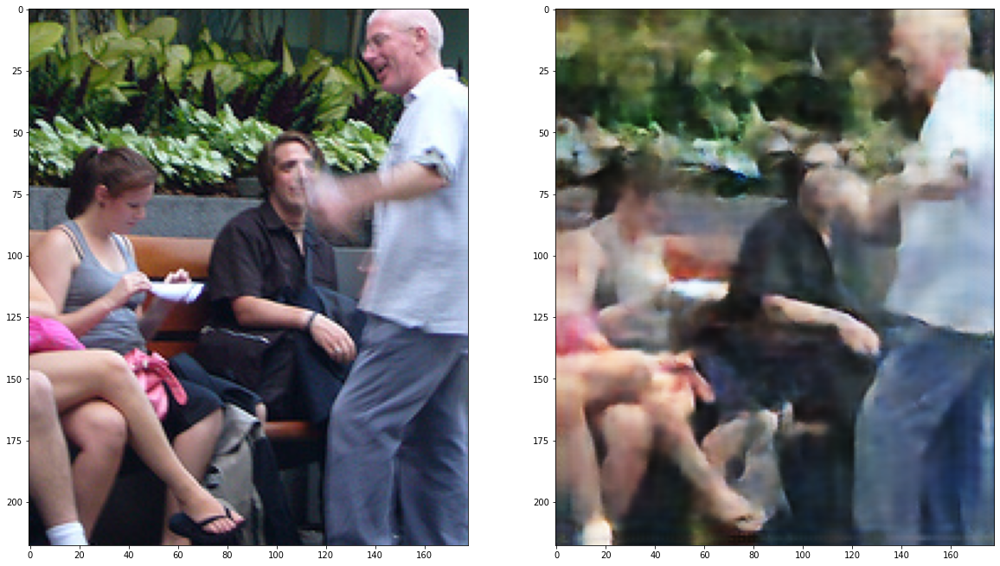

[2/30][0/20]	Loss_D: 1.3864	Loss_G: 0.9756	Loss_E: 0.9756	D(x): 0.4986	D(G(z)): 0.4988 / 0.4798


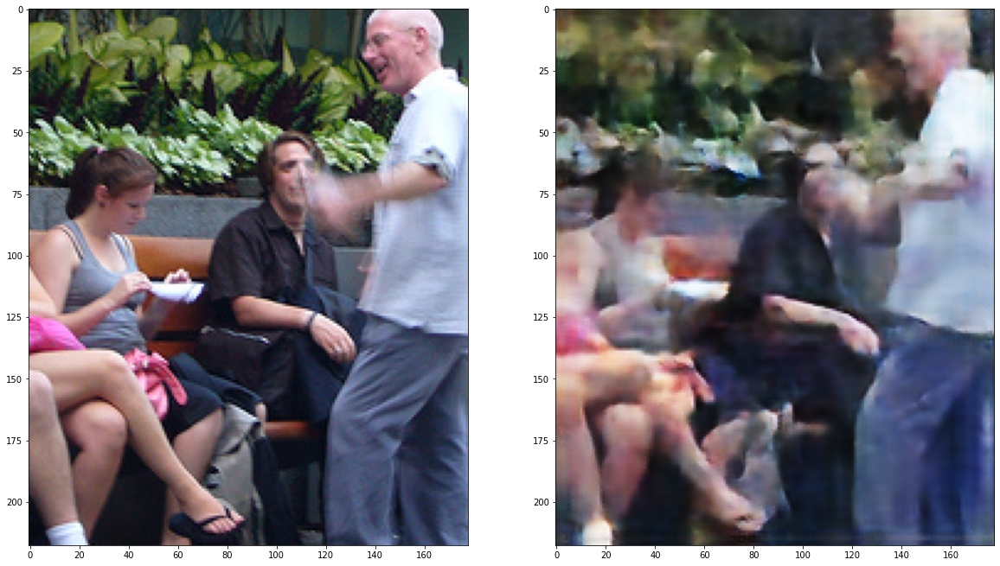

[3/30][0/20]	Loss_D: 1.3920	Loss_G: 0.9626	Loss_E: 0.9626	D(x): 0.5413	D(G(z)): 0.5404 / 0.4727


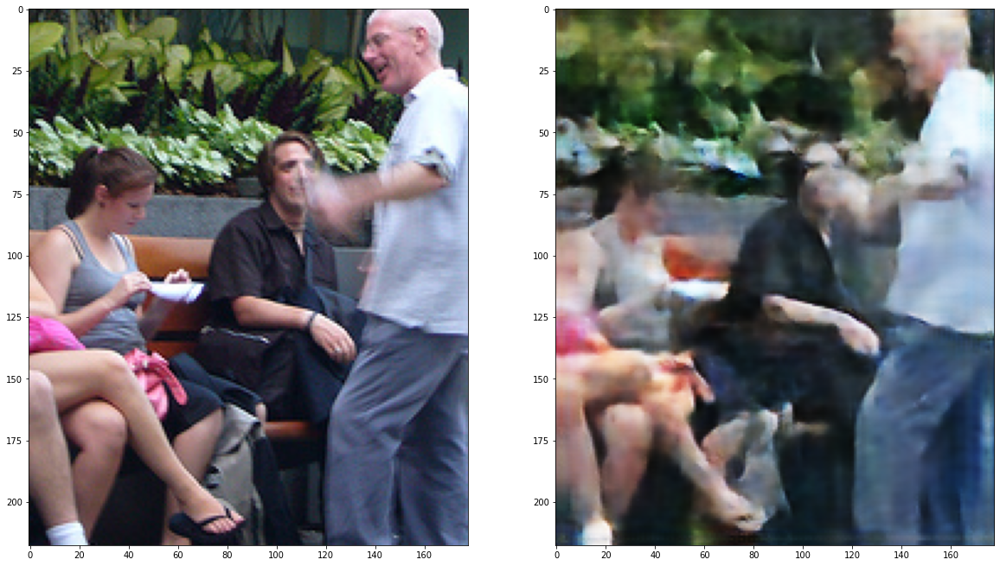

[4/30][0/20]	Loss_D: 1.3830	Loss_G: 1.0197	Loss_E: 1.0197	D(x): 0.4724	D(G(z)): 0.4670 / 0.4586


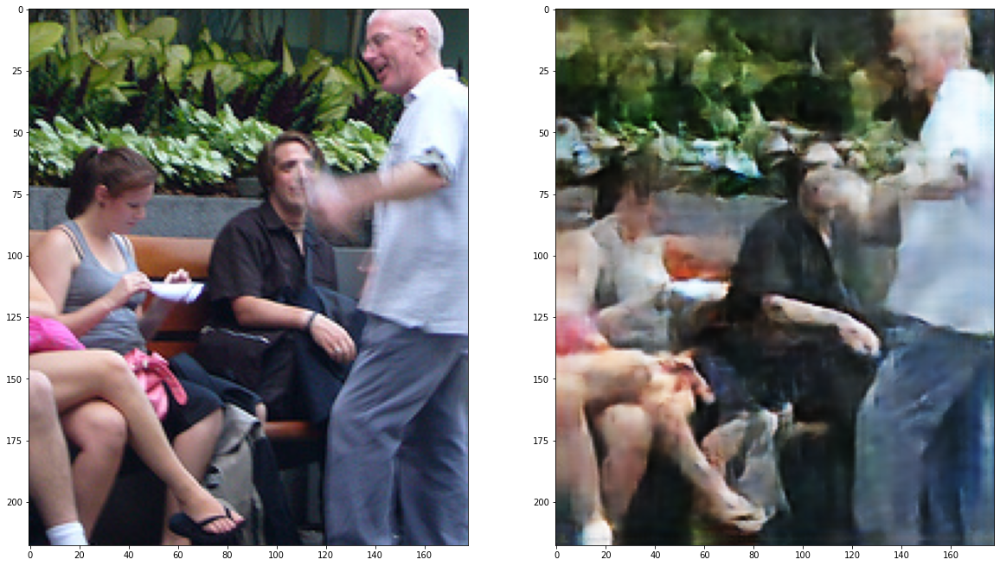

[5/30][0/20]	Loss_D: 1.3926	Loss_G: 0.9557	Loss_E: 0.9557	D(x): 0.4789	D(G(z)): 0.4802 / 0.5086


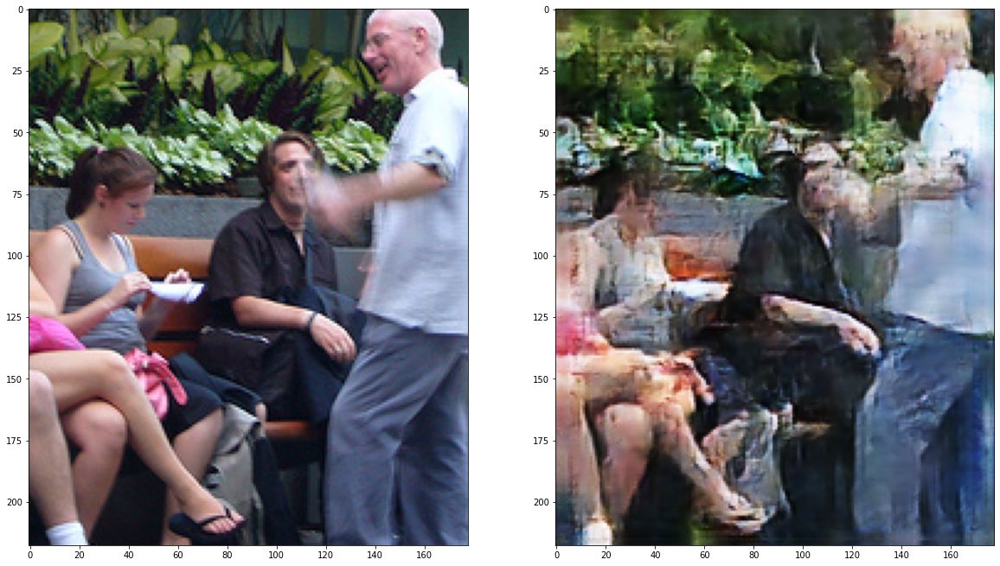

[6/30][0/20]	Loss_D: 1.3782	Loss_G: 0.9943	Loss_E: 0.9943	D(x): 0.5242	D(G(z)): 0.5175 / 0.4801


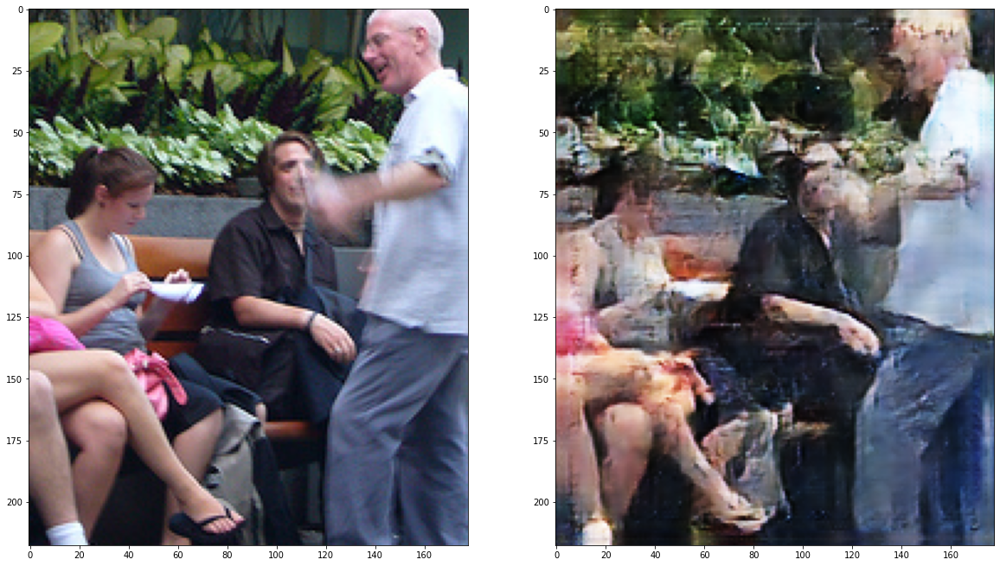

[7/30][0/20]	Loss_D: 1.3877	Loss_G: 0.9515	Loss_E: 0.9515	D(x): 0.4623	D(G(z)): 0.4600 / 0.4822


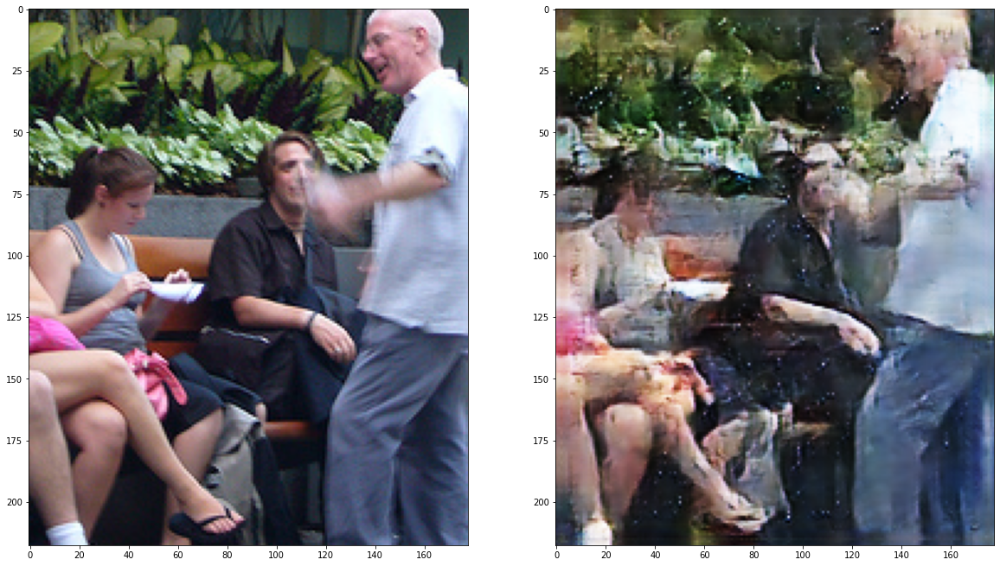

[8/30][0/20]	Loss_D: 1.4079	Loss_G: 0.9943	Loss_E: 0.9943	D(x): 0.4453	D(G(z)): 0.4506 / 0.4941


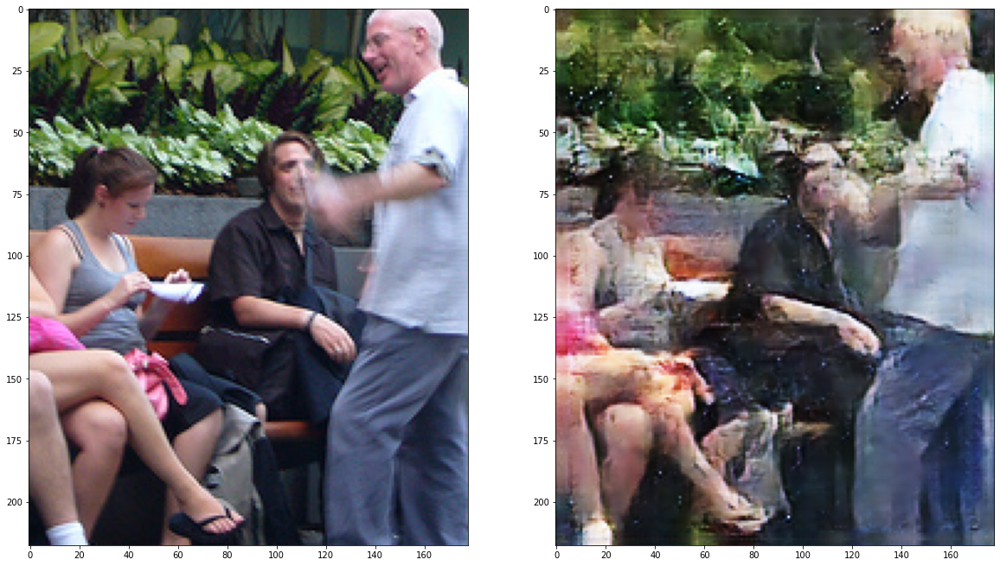

[9/30][0/20]	Loss_D: 1.3742	Loss_G: 0.9713	Loss_E: 0.9713	D(x): 0.5043	D(G(z)): 0.4974 / 0.4824


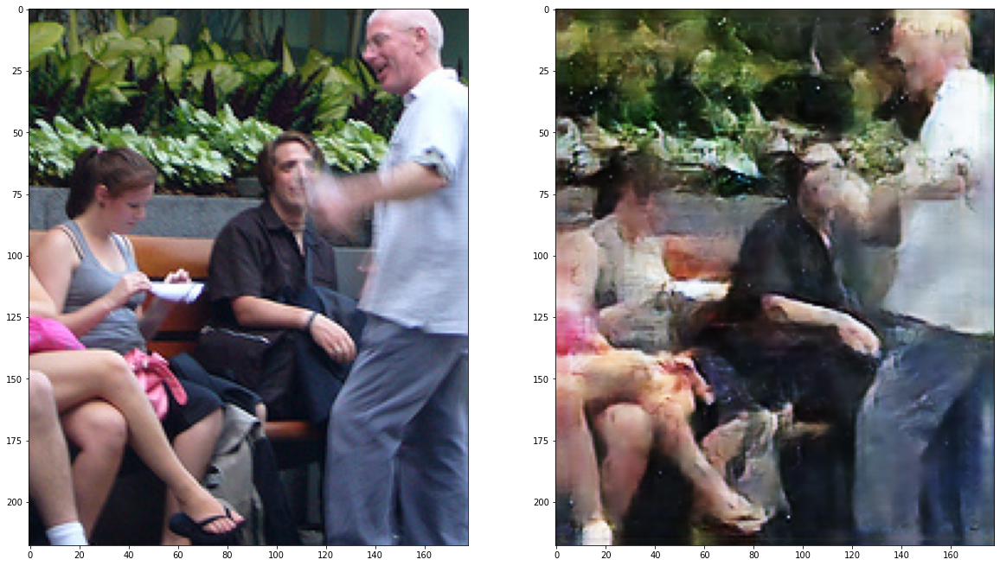

[10/30][0/20]	Loss_D: 1.3810	Loss_G: 0.9561	Loss_E: 0.9561	D(x): 0.5430	D(G(z)): 0.5370 / 0.5066


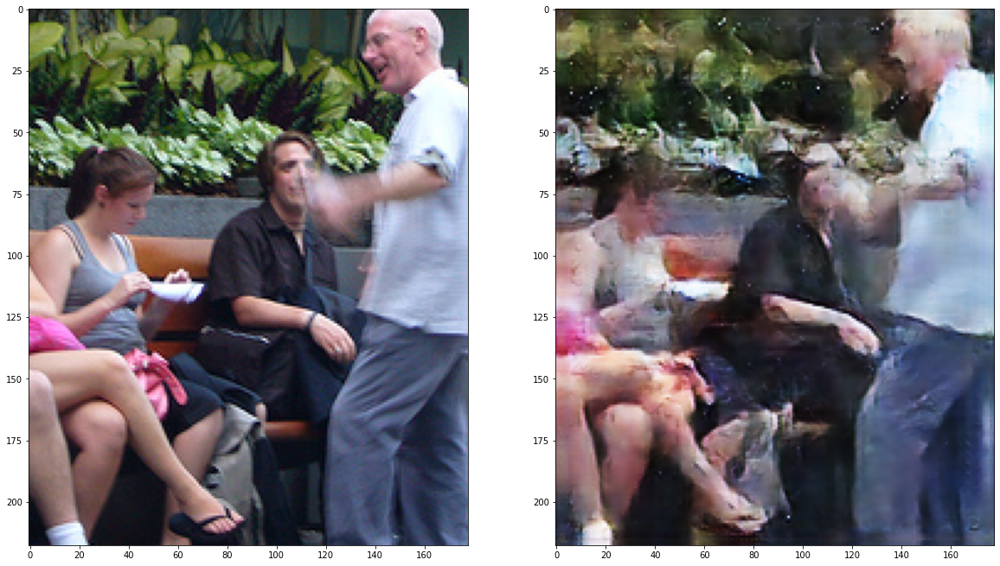

[11/30][0/20]	Loss_D: 1.3744	Loss_G: 0.9541	Loss_E: 0.9541	D(x): 0.4939	D(G(z)): 0.4857 / 0.4994


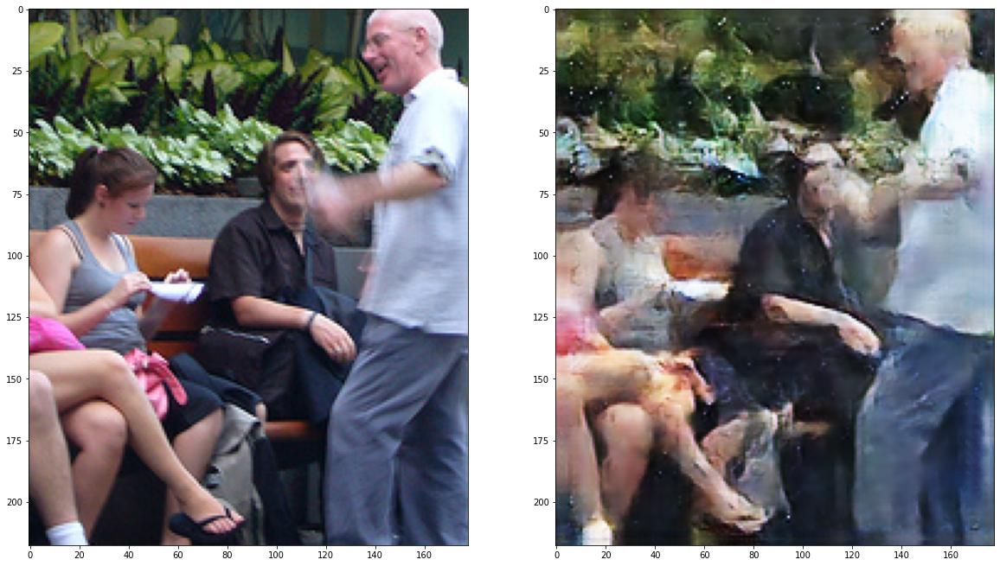

[12/30][0/20]	Loss_D: 1.3861	Loss_G: 0.8947	Loss_E: 0.8947	D(x): 0.5434	D(G(z)): 0.5395 / 0.5130


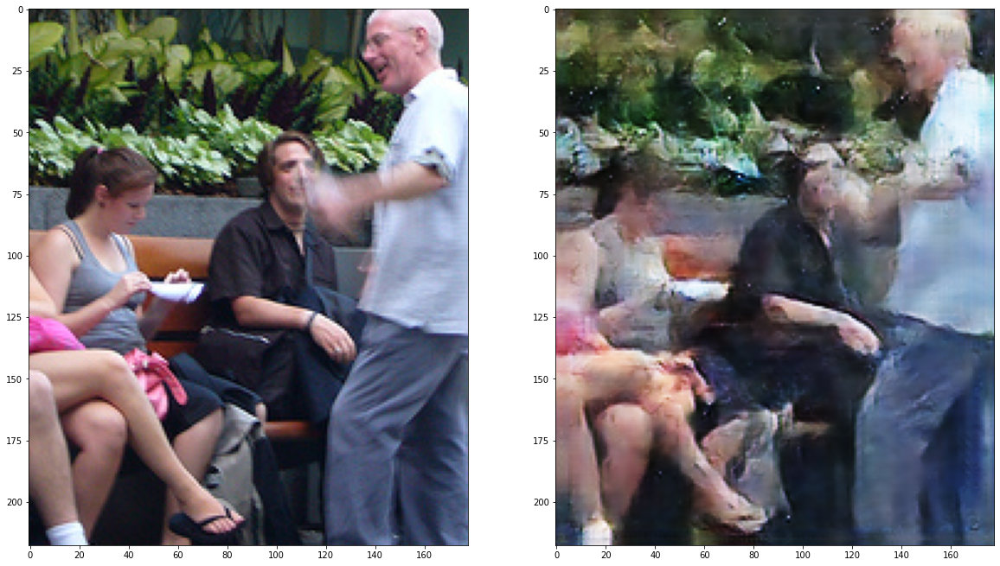

[13/30][0/20]	Loss_D: 1.3961	Loss_G: 0.9332	Loss_E: 0.9332	D(x): 0.5096	D(G(z)): 0.5157 / 0.5357


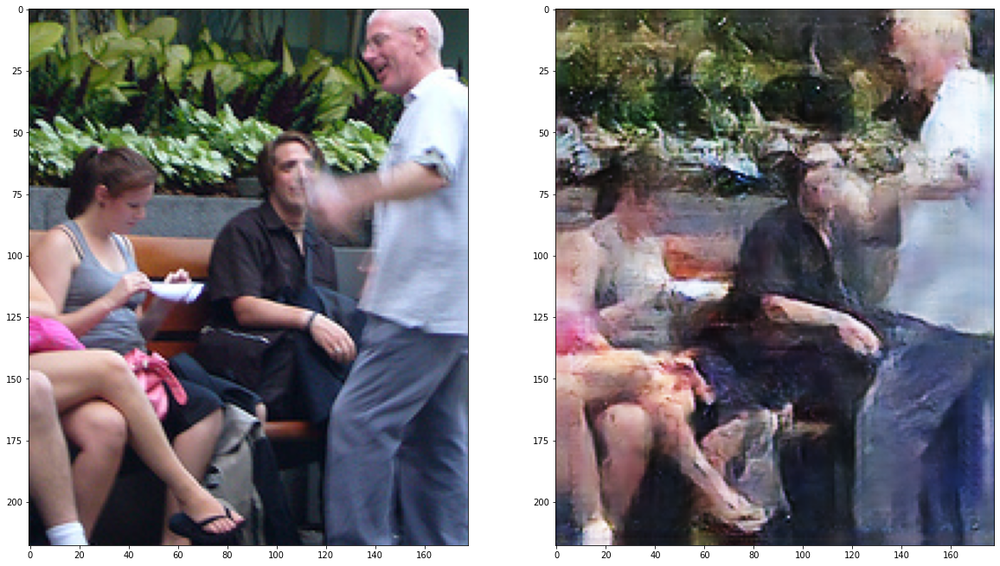

[14/30][0/20]	Loss_D: 1.3998	Loss_G: 0.9819	Loss_E: 0.9819	D(x): 0.4754	D(G(z)): 0.4823 / 0.4903


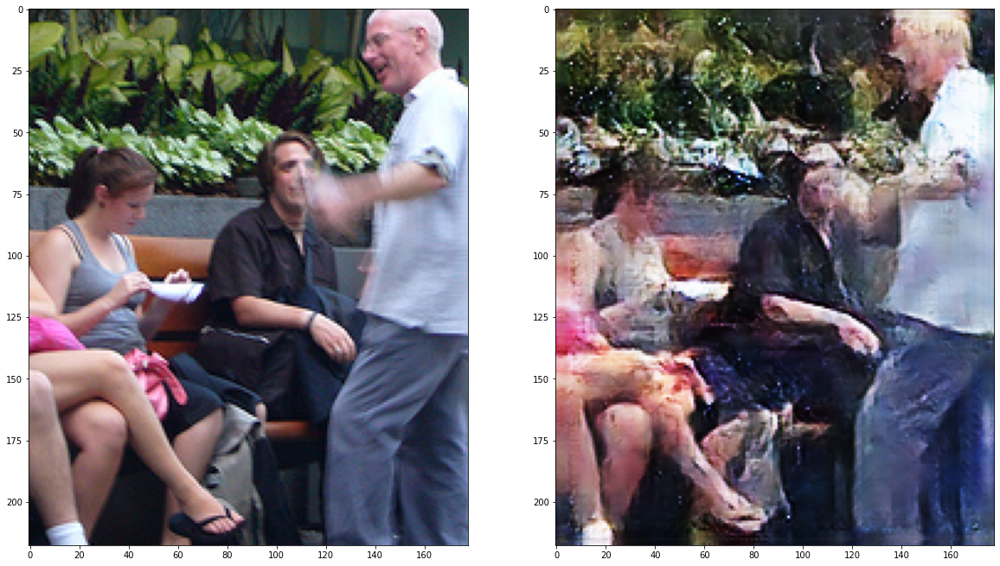

[15/30][0/20]	Loss_D: 1.3781	Loss_G: 0.9817	Loss_E: 0.9817	D(x): 0.5338	D(G(z)): 0.5264 / 0.4812


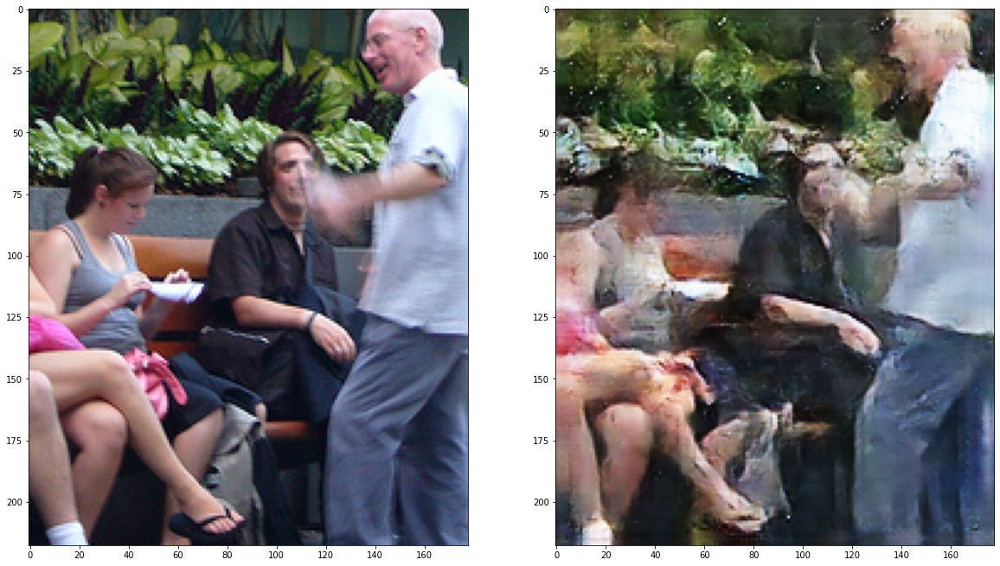

[16/30][0/20]	Loss_D: 1.3700	Loss_G: 0.9179	Loss_E: 0.9179	D(x): 0.5155	D(G(z)): 0.5070 / 0.5123


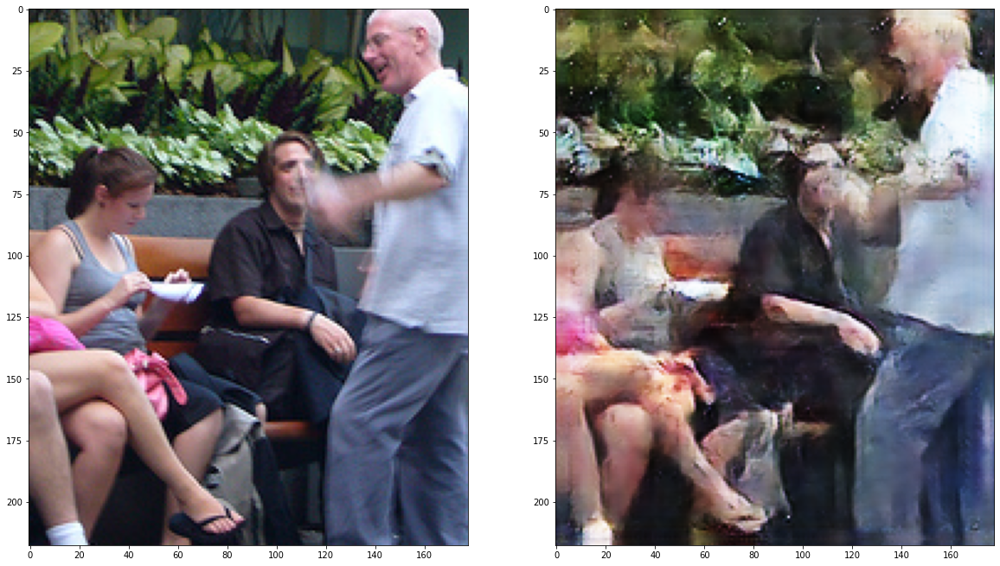

[17/30][0/20]	Loss_D: 1.3838	Loss_G: 0.8966	Loss_E: 0.8966	D(x): 0.4981	D(G(z)): 0.4958 / 0.5289


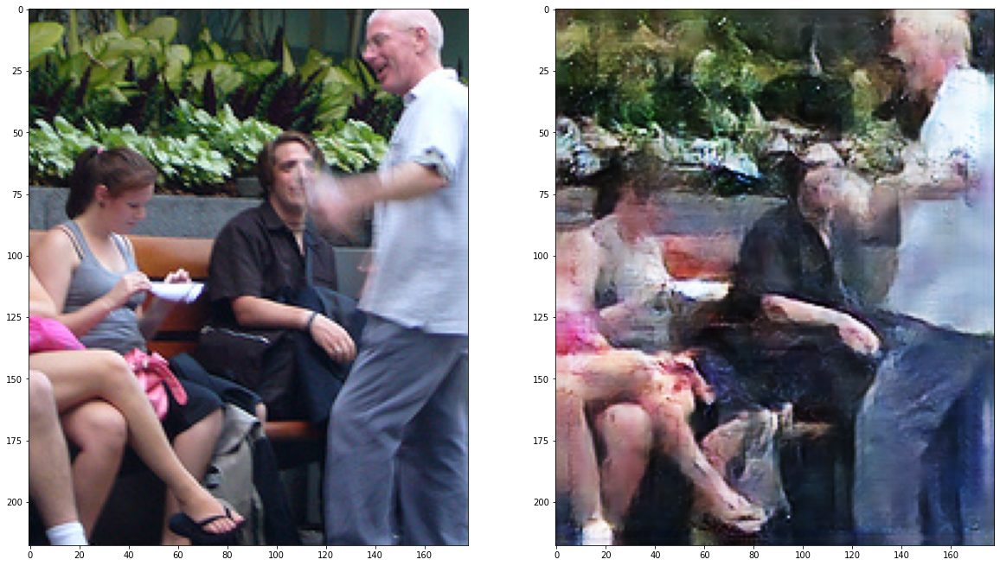

[18/30][0/20]	Loss_D: 1.4009	Loss_G: 0.9151	Loss_E: 0.9151	D(x): 0.4668	D(G(z)): 0.4691 / 0.5356


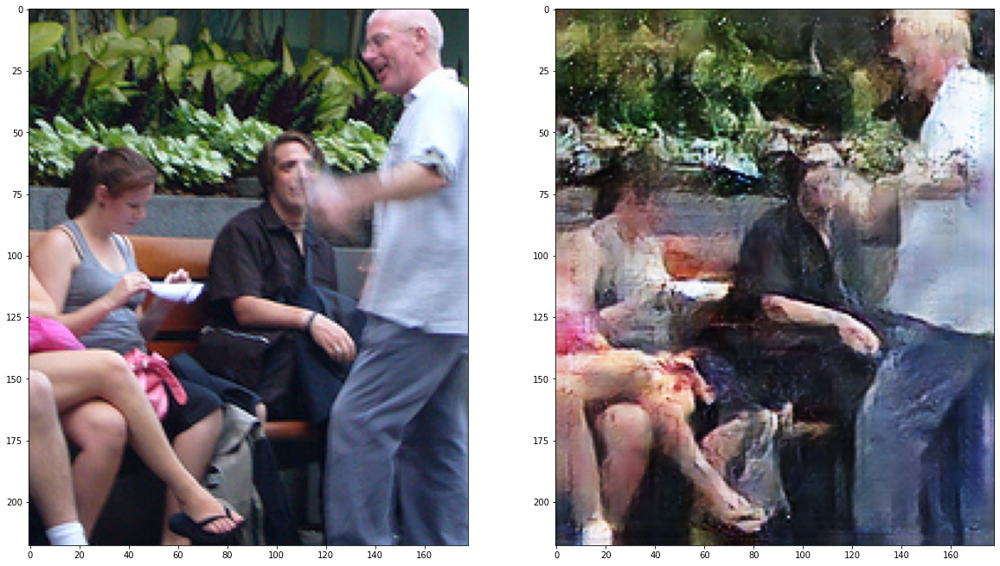

[19/30][0/20]	Loss_D: 1.3866	Loss_G: 0.9541	Loss_E: 0.9541	D(x): 0.5202	D(G(z)): 0.5191 / 0.4967


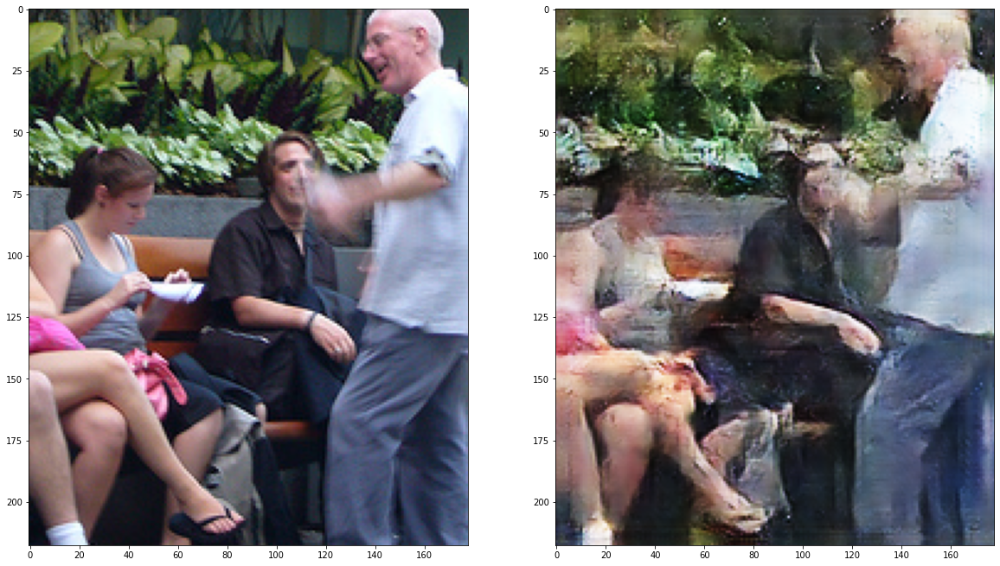

[20/30][0/20]	Loss_D: 1.3736	Loss_G: 0.9750	Loss_E: 0.9750	D(x): 0.5085	D(G(z)): 0.5006 / 0.4987


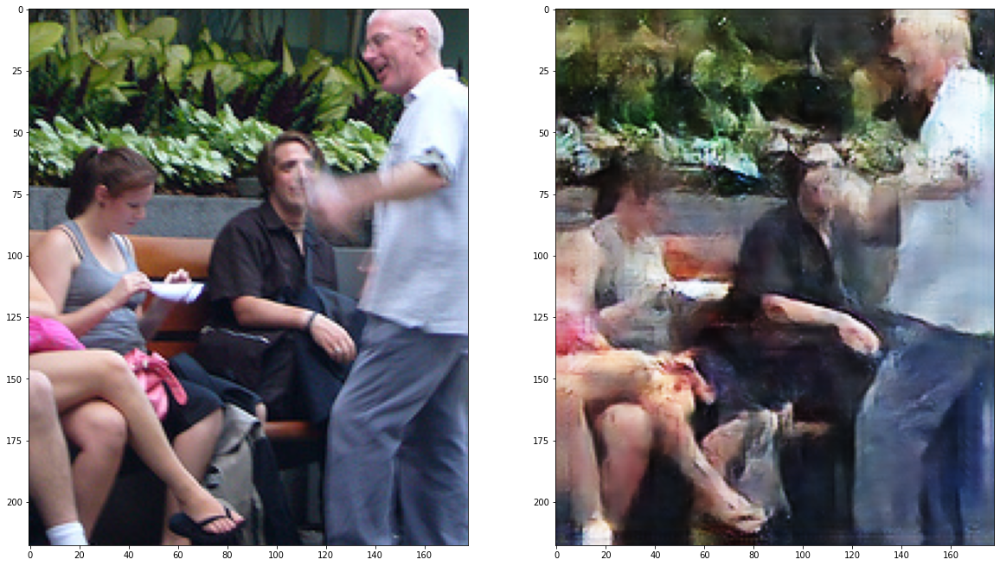

[21/30][0/20]	Loss_D: 1.3866	Loss_G: 0.9481	Loss_E: 0.9481	D(x): 0.4900	D(G(z)): 0.4887 / 0.4960


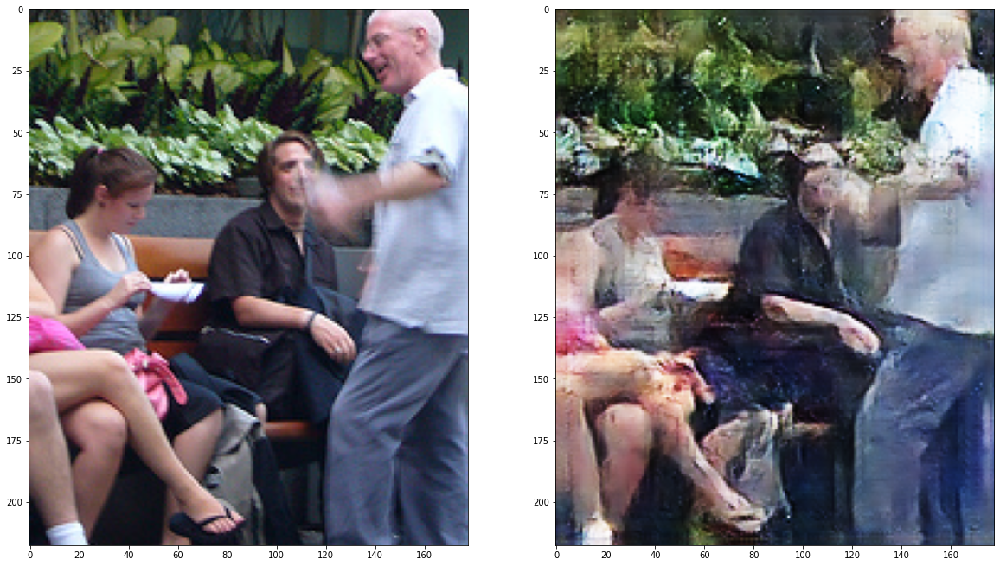

[22/30][0/20]	Loss_D: 1.3968	Loss_G: 0.9104	Loss_E: 0.9104	D(x): 0.5081	D(G(z)): 0.5129 / 0.5278


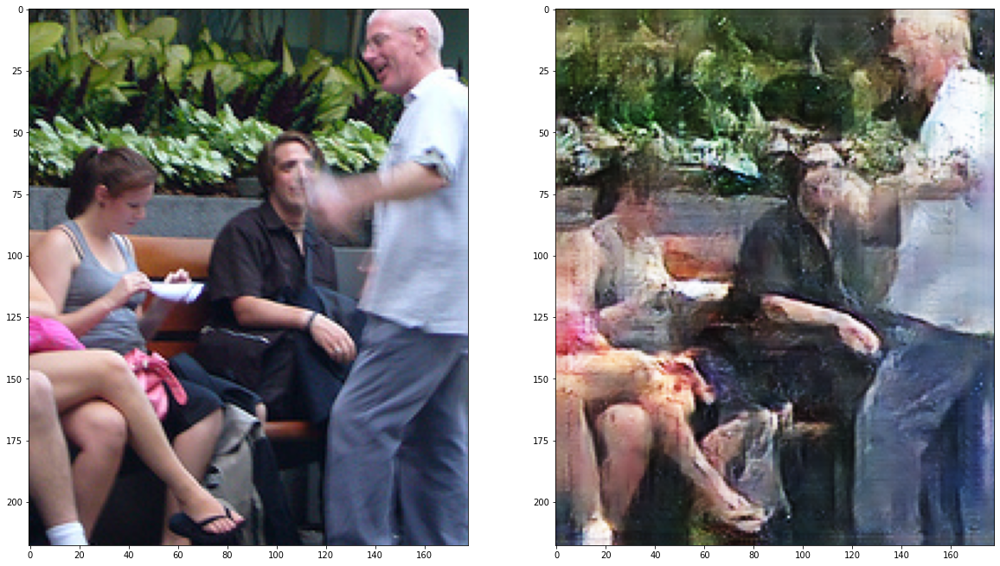

[23/30][0/20]	Loss_D: 1.4001	Loss_G: 0.9462	Loss_E: 0.9462	D(x): 0.5104	D(G(z)): 0.5175 / 0.5040


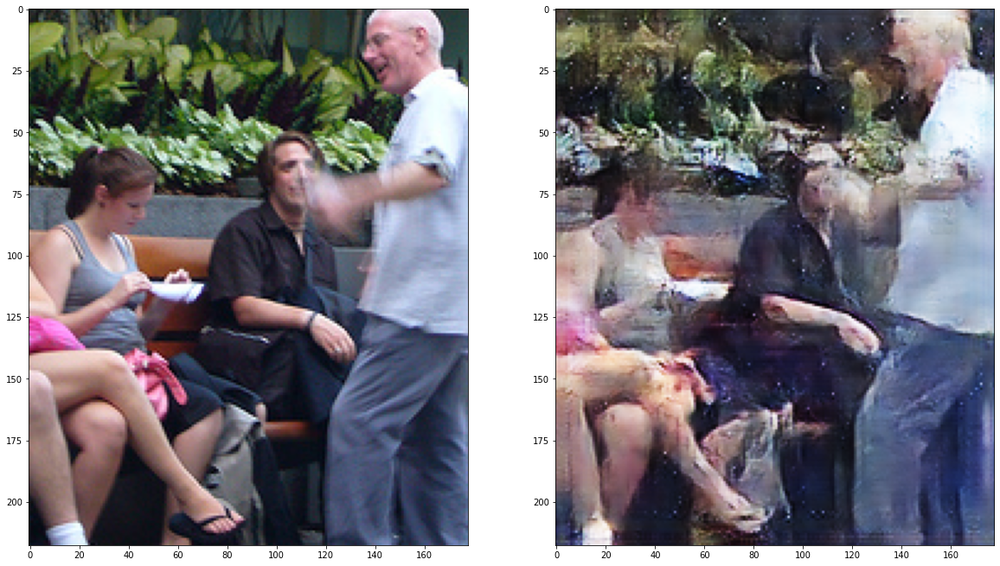

[24/30][0/20]	Loss_D: 1.3782	Loss_G: 0.9135	Loss_E: 0.9135	D(x): 0.5028	D(G(z)): 0.4980 / 0.5016


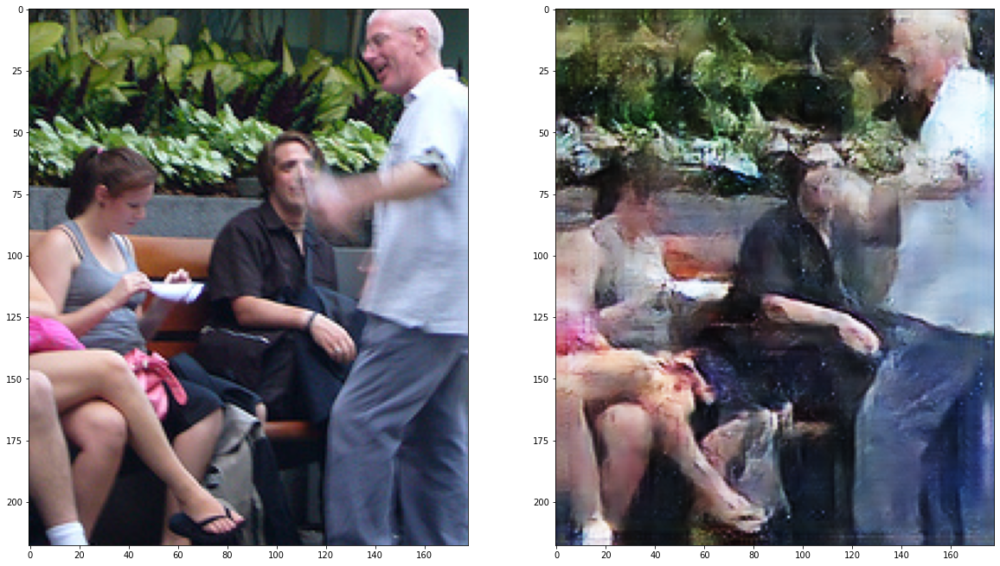

[25/30][0/20]	Loss_D: 1.4005	Loss_G: 1.0168	Loss_E: 1.0168	D(x): 0.5273	D(G(z)): 0.5335 / 0.4729


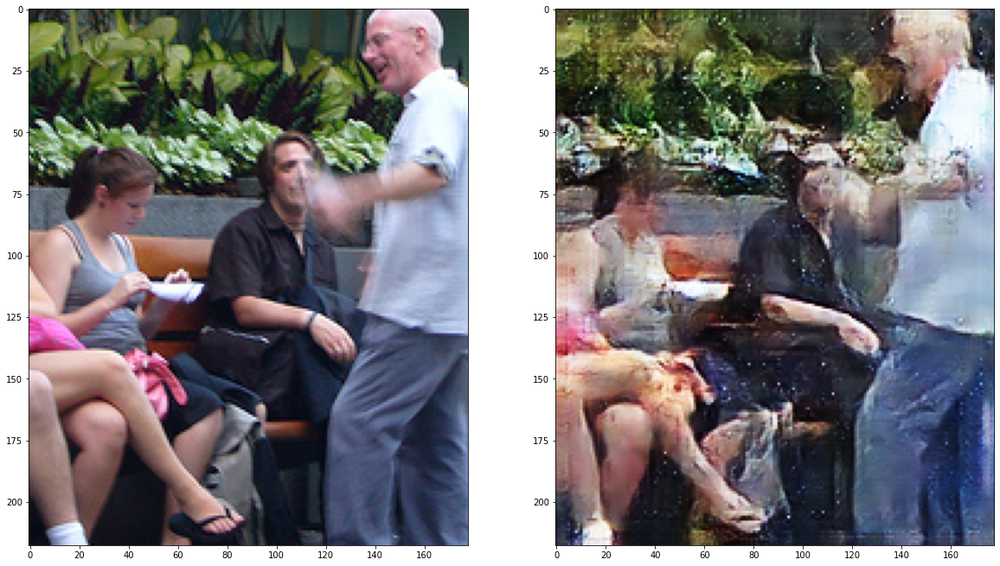

[26/30][0/20]	Loss_D: 1.3859	Loss_G: 0.9195	Loss_E: 0.9195	D(x): 0.5037	D(G(z)): 0.5034 / 0.4956


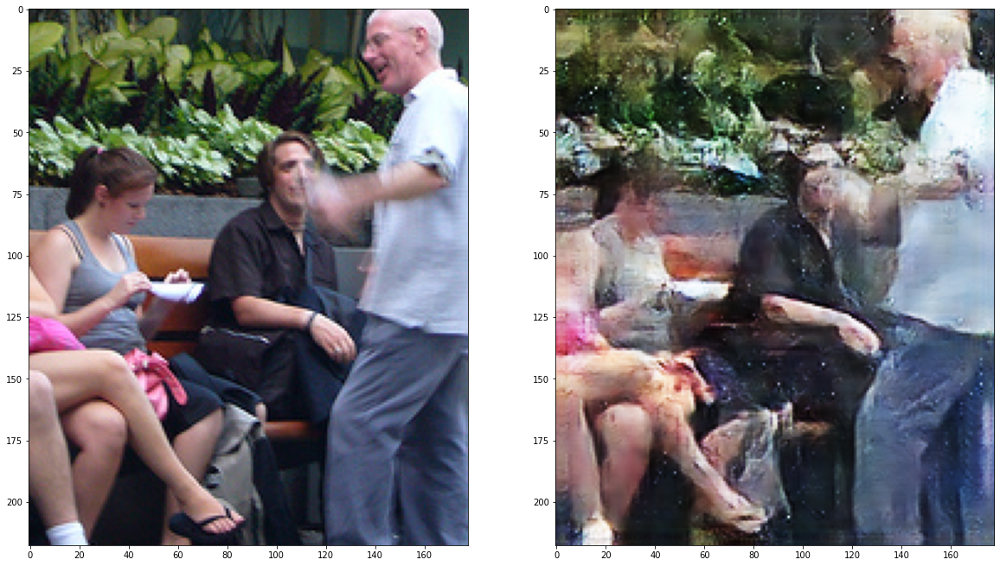

[27/30][0/20]	Loss_D: 1.3792	Loss_G: 0.9206	Loss_E: 0.9206	D(x): 0.4845	D(G(z)): 0.4789 / 0.4989


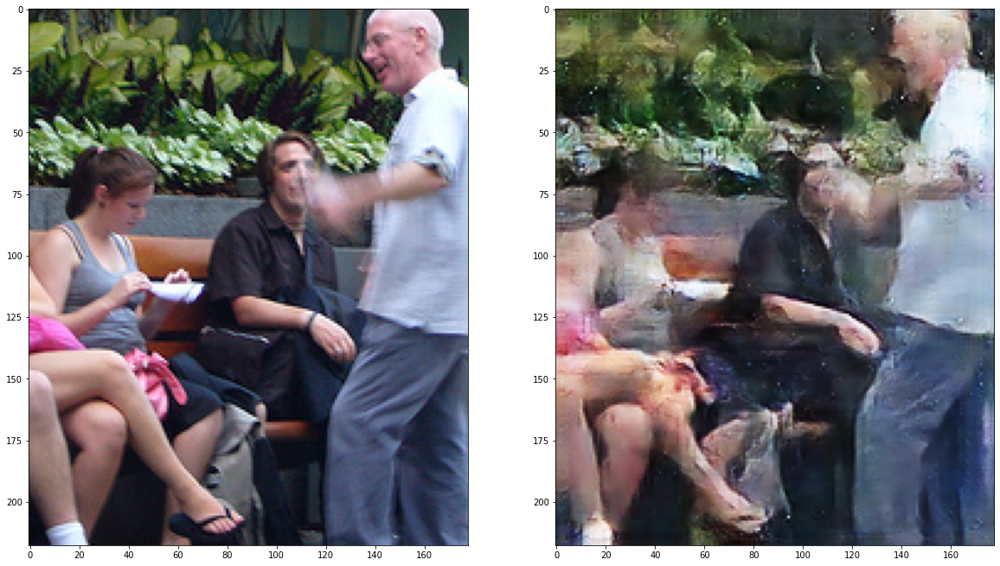

[28/30][0/20]	Loss_D: 1.3704	Loss_G: 1.0052	Loss_E: 1.0052	D(x): 0.5197	D(G(z)): 0.5095 / 0.4764


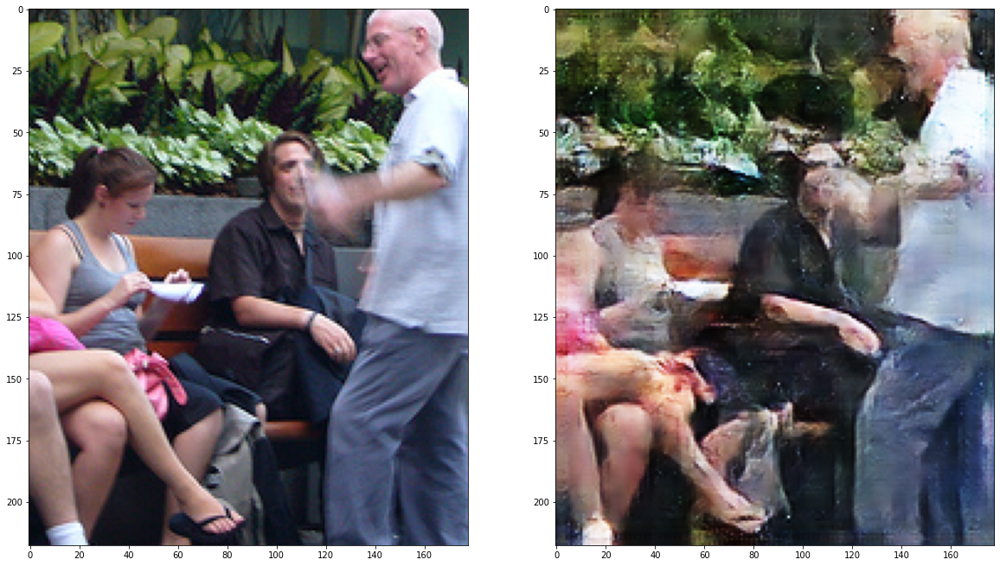

[29/30][0/20]	Loss_D: 1.3973	Loss_G: 0.9030	Loss_E: 0.9030	D(x): 0.4720	D(G(z)): 0.4737 / 0.5032


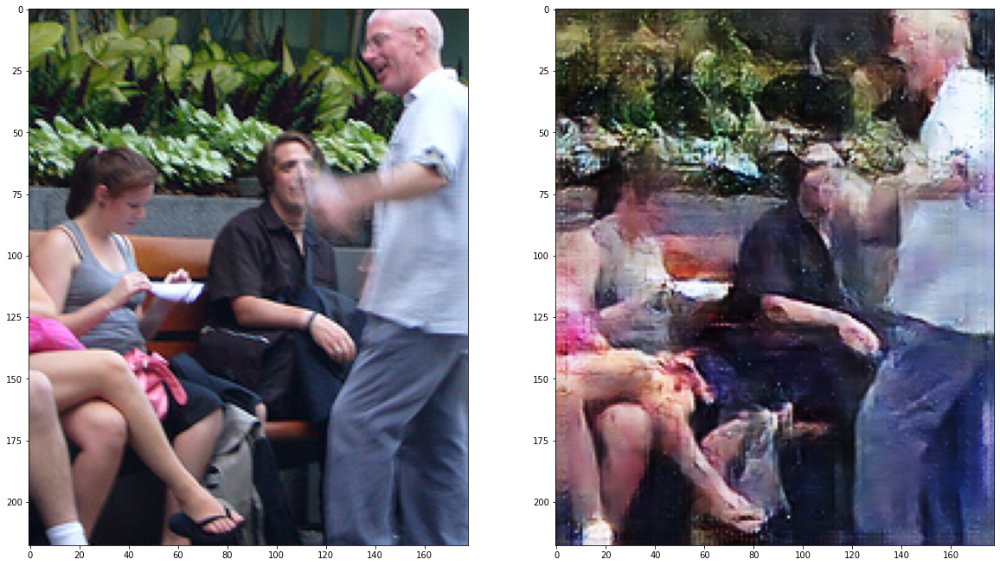

In [27]:
iters = 0
num_epochs = 30
netG.load_state_dict(torch.load("/content/drive/MyDrive/netG8.model"))
netE.load_state_dict(torch.load("/content/drive/MyDrive/netE8.model"))
#netD.load_state_dict(torch.load("/content/drive/MyDrive/netD8.model"))
for epoch in range(num_epochs):
    torch.save(netE.state_dict(), "netE"+str(num_channels_in_encoder)+".model")
    torch.save(netG.state_dict(), "netG"+str(num_channels_in_encoder)+".model")
    #torch.save(netD.state_dict(), "netD"+str(num_channels_in_encoder)+".model")
    for i, (images) in enumerate(dataloader, 0):
        netG.train()
        netD.train()
        netE.train()
        
        netD.zero_grad()
        
        images = images.to(device)
        fake_images = netG(netE(images))
        #ACTUALIZAR EL DISCRIMINADOR
        inp_x = {}
        inp_x['img']=images
        inp_x['encoded'] = netE(images)
        
        label = torch.FloatTensor(np.random.uniform(low=0.855, high=0.999, size=(images.size(0)))).to(device)
        output = netD(inp_x).view(-1)
        #CALCULAMOS LA PERDIDA
        errD_real = criterion(output, label)
        #CALCULAMOS LA GRADIENTE HACIA ATRAS
        errD_real.backward(retain_graph=True)
        D_x = output.mean().item()
        
        inp_x_fake = {}
        inp_x_fake['img']=fake_images
        inp_x_fake['encoded'] = netE(images)
        label = torch.FloatTensor(np.random.uniform(low=0.005, high=0.155, size=(images.size(0)))).to(device)
        output = netD(inp_x_fake).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward(retain_graph=True)
        D_G_z1 = output.mean().item()
        
        errD = errD_real + errD_fake
        
        optimizerD.step()

        
        #ACTUALIZAMOS LOS VALORES DEL GENERADOR
        
        netG.zero_grad()
        inp_x_fake = {}
        inp_x_fake['img']=fake_images
        inp_x_fake['encoded'] = netE(images)
        
        label = torch.FloatTensor(np.random.uniform(low=0.895, high=0.999, size=(images.size(0)))).to(device)
        output = netD(inp_x_fake).view(-1)
        
        errG = criterion(output, label) + 2*l1criterion(images,fake_images)
        errG.backward(retain_graph=True)
        
        errE = criterion(output, label) + 2*l1criterion(images,fake_images)
        errE.backward(retain_graph=True)
        
        D_G_z2 = output.mean().item()
        optimizerG.step()

        
        netE.zero_grad()
        inp_x_fake = {}
        inp_x_fake['img']=fake_images
        inp_x_fake['encoded'] = netE(images)
        
        #label = torch.FloatTensor(np.random.uniform(low=0.895, high=0.999, size=(images.size(0)))).to(device)
        #output = netD(inp_x_fake).view(-1)

        
        E_G_z2 = output.mean().item()
        optimizerE.step()
        
        #Imprimiendo las salidas en funciona la perdida de cada red GAN
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tLoss_E: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(),errE.item(), D_x, D_G_z1, D_G_z2))

        #Guardamos los valores de perdida
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        E_losses.append(errE.item())

        del images
        del inp_x_fake
        del inp_x
        del label
        del output
        torch.cuda.empty_cache()
        iters += 1
        
        
        
        if i%500 ==0:
            netE.eval()
            netG.eval()
            encoded_img = netE(valid_batch)
            reconstructed_img = netG(encoded_img)
            f, axarr = plt.subplots(num_images_to_show,2)
            for i in range(num_images_to_show):
                validimg = (valid_batch[i].cpu().detach().permute(1, 2, 0) * 0.5) + 0.5
                rec_img = (reconstructed_img[i].cpu().detach().permute(1, 2, 0) *0.5 ) + 0.5
                axarr[0].imshow(validimg)
                axarr[1].imshow(rec_img)
                f.set_figheight(20)
                f.set_figwidth(20)
            plt.show()

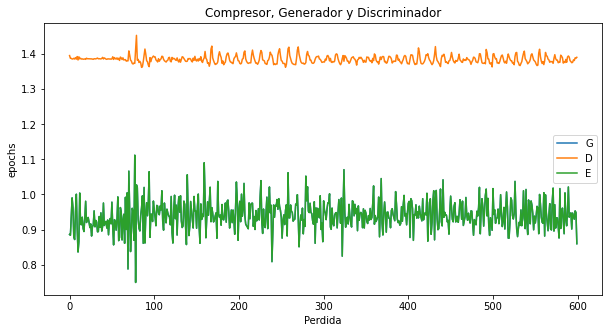

In [42]:
plt.figure(figsize=(10,5))
plt.title("Compresor, Generador y Discriminador")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.plot(E_losses,label="E")
plt.ylabel("epochs")
plt.xlabel("Perdida")
plt.legend()
plt.show()

In [29]:
with open('dataG.txt', 'a') as fp:
  for i in G_losses:
    fp.write("%s " %i)
with open('dataD.txt', 'a') as fp:
  for i in D_losses:
    fp.write("%s " %i)
with open('dataE.txt', 'a') as fp:
  for i in E_losses:
    fp.write("%s " %i)

In [30]:
tot_img_size = IMG_WIDTH * IMG_HEIGHT * 3
valid_dataset = ImageData(is_train=False)
batch_size=20
valid_dataloader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=True)
valid_batch = next(iter(valid_dataloader)).to(device)

In [31]:
print(valid_batch.shape)
encoded_img = netE(valid_batch)
print(encoded_img.shape)
reconstructed_img = netG(encoded_img)
print(reconstructed_img.shape)

torch.Size([20, 3, 218, 178])
torch.Size([20, 8, 54, 44])
torch.Size([20, 3, 218, 178])


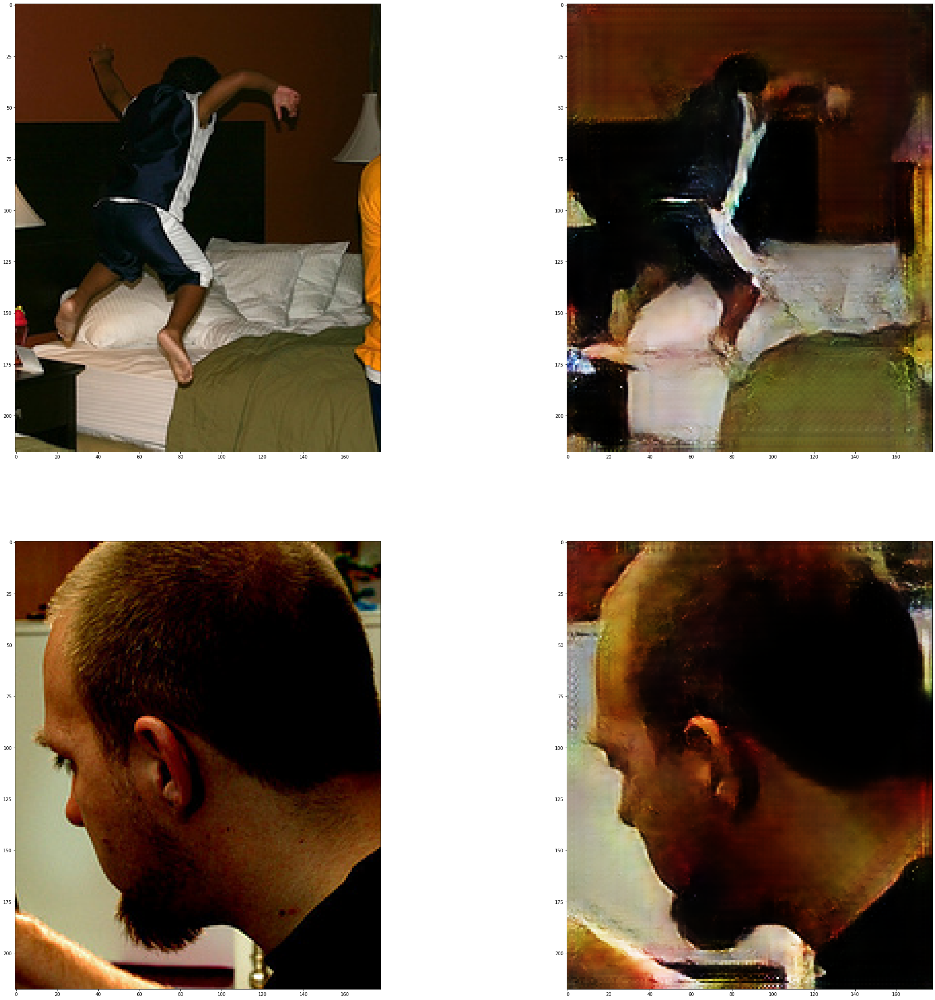

<Figure size 432x288 with 0 Axes>

In [45]:
num_images_to_show = 2
f, axarr = plt.subplots(num_images_to_show,2)
for i in range(num_images_to_show):
    validimg = (valid_batch[i].cpu().detach().permute(1, 2, 0) * 0.5) + 0.5
    rec_img = (reconstructed_img[i].cpu().detach().permute(1, 2, 0) *0.5) + 0.5
    axarr[i,0].imshow(validimg)
    axarr[i,1].imshow(rec_img)
    f.set_figheight(40)
    f.set_figwidth(40)
plt.show()

plt.savefig('results.png')
f.savefig('resultado.png')
